# Outlier detection for time series
In this groupwork we will try to remove pointwise outliers from three synthetic datasets using saliency scores $s_t$.

One way to produce saliency scores is to use a forecaster:
$$\hat{x}_{t+1} = f(x_{t|T})$$

then, for example, $s$ could be defined as
$$s_{t+1} = \begin{cases}
x_{t+1}-q_{0.99}   \quad \text{if} \quad x_{t+1}>q_{0.99}\\
q_{0.01} - x_{t+1} \quad \text{if} \quad x_{t+1}<q_{0.01}
\end{cases}$$

where $q_{0.99}$ and $q_{0.01}$ are the 99% and 1%, theoretic or empirical, quantiles of the predictions.

Feel free to use any other methods!


In [58]:
import pandas as pd
import matplotlib.pyplot as plt
df = pd.read_csv('https://raw.githubusercontent.com/nepslor/teaching/main/TimeSeriesForecasting/data/outliers.csv', index_col=0)

In [59]:
data = df.copy()
data

,0,1,2
0,0.001182,0.021295,0.055034
1,0.011919,-0.000174,0.057223
2,-0.008571,0.079687,0.083479
3,-0.007542,0.044413,0.055085
4,0.002404,0.036926,0.041715
...,...,...,...
87595,-0.104829,0.055929,-0.048878
87596,-0.108703,0.033958,-0.036777
87597,-0.091489,0.024739,-0.023133
87598,-0.099915,0.027502,-0.046972


In [60]:
import plotly.express as px
import plotly.subplots as sp

# Create subplots
fig = sp.make_subplots(rows=3, cols=2, subplot_titles=[f"Column {i}" for i in range(3)]*2)

# Plot each column
for i, col in enumerate(data.columns):
    fig.add_trace(px.line(data, y=col).data[0], row=i+1, col=1)
    fig.add_trace(px.line(data.iloc[:2000], y=col).data[0], row=i+1, col=2)

fig.update_layout(height=1000, width=1200, title_text="Interactive Time Series Plots")
fig.show()


The three datasets present the following characteristics:
1. Mostly out-of-distributions outliers: these outliers are higher or lower than the maximum observed values, and are easy to find. Watch out! Some other suspicious points could still be present!
2. Few local outliers. These cannot be filter out using a filter on the entire distribution, a sliding window method should be used.
3. A lot local outliers. Some methods could fail to spot those, since more than one could be present in the sliding window. Possibly an iterative method (in which outliers are spotted and replaced sequentially) could help.



# ❓ Your turn!
For this challenge you can reuse any technique or code we have seen in the previous exercises. The final evaluation metric is the $F1$ score, defined as:
$$F1 = 2/(1/precision + 1/recall)$$
Where
$$precision = TP/\hat{P}$$
$$recall = TP/P$$
That is, precision and recall are the ratio of points labeled as positive and being indeed positive (true positive) over the number of predicted positive points or effective positive points.


In [61]:
#fit a fourier transform to the data
import numpy as np
from scipy.fft import fft
from scipy.signal import find_peaks
from scipy.signal import periodogram

# Compute the Fast Fourier Transform
frequencies = fft(data["0"])
frequencies

# Compute the power spectral density
frequencies = np.abs(frequencies)**2
frequencies

# Find the peaks
peaks, _ = find_peaks(frequencies)
peaks

# Plot the power spectral density using plotly
import plotly.graph_objects as go

fig = go.Figure()

# Add the power spectral density line
fig.add_trace(go.Scatter(y=frequencies, mode='lines', name='Power Spectral Density'))

# Add the peaks
fig.add_trace(go.Scatter(x=peaks, y=frequencies[peaks], mode='markers', name='Peaks'))

# Update layout
fig.update_layout(
    title="Power Spectral Density",
    xaxis_title="Frequency",
    yaxis_title="Power"
)

fig.show()



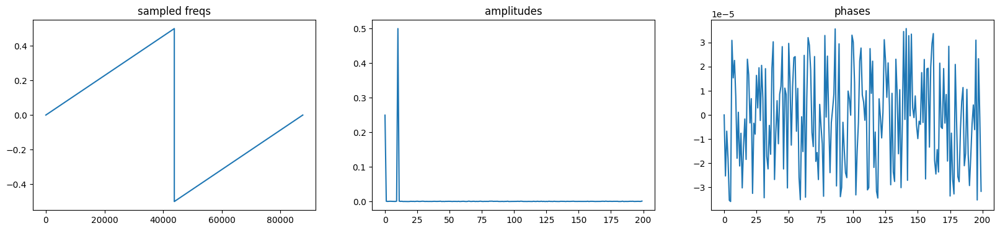

In [62]:
from numpy import fft
l=len(data)
x_freqdom = fft.fft(data["0"])

fig, ax = plt.subplots(1, 3, figsize=(20, 4))
ax[0].plot(fft.fftfreq(l))
ax[1].plot(np.absolute(x_freqdom)[:200] / l)
ax[2].plot(np.angle(x_freqdom)[:200] / l)
[a.set_title(t) for a, t in zip(ax, ['sampled freqs', 'amplitudes', 'phases'])];


In [63]:
def fourierExtrapolation(x, n_predict, n_h=10):
    n = x.size
    x_freqdom = fft.fft(x)  # x in frequency domain
    f = fft.fftfreq(n)      # frequencies

    # sort indexes by frequency, lower -> higher
    indexes = np.argsort(np.absolute(f))

    t = np.arange(0, n + n_predict)
    restored_sig = np.zeros(t.size)
    for i in indexes[:1 + n_h * 2]:
        ampli = np.absolute(x_freqdom[i]) / n   # amplitude
        phase = np.angle(x_freqdom[i])          # phase
        restored_sig += ampli * np.cos(2 * np.pi * f[i] * t + phase)
    return restored_sig

In [64]:
import plotly.graph_objects as go

fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])
extrapolated_data = []
n_h = 1000
# Plot the Fourier extrapolation
for col in range(3):
    fig.add_trace(go.Scatter(y=data[f"{col}"], mode='lines', name=f'Original_Data_Col_{col}', line=dict(width=1)), row=col+1, col=1)
    extrapolated_data.append(fourierExtrapolation(data[f"{col}"], 0, n_h*(col+1)))
    fig.add_trace(go.Scatter(y=extrapolated_data[col], mode='lines', name=f'n_h: {n_h*(col+1)}', line=dict(width=4)), row=col+1, col=1)

# Update layout
fig.update_layout(
    title="Fourier Extrapolation",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)

fig.show()

In [65]:
# plot data[0] - extrapolated_data
fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])

for col in range(3):
    fig.add_trace(go.Scatter(y=data[f"{col}"] - extrapolated_data[col], mode='lines', name=f'Difference', line=dict(width=1)), row=col+1, col=1)
# Plot the difference

fig.update_layout(
    title="Fourier Extrapolation",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)
fig.show()

In [66]:
# add a column outlier_first_pass_0 to the data
for col in range(3):
    data[f"outlier_first_pass_{col}"] = np.abs(data[f"{col}"] - extrapolated_data[col]) > (5 * np.std(data[f"{col}"] - extrapolated_data[col]))

In [67]:
data

,0,1,2,outlier_first_pass_0,outlier_first_pass_1,outlier_first_pass_2
0,0.001182,0.021295,0.055034,False,False,False
1,0.011919,-0.000174,0.057223,False,False,False
2,-0.008571,0.079687,0.083479,False,False,False
3,-0.007542,0.044413,0.055085,False,False,False
4,0.002404,0.036926,0.041715,False,False,False
...,...,...,...,...,...,...
87595,-0.104829,0.055929,-0.048878,False,False,False
87596,-0.108703,0.033958,-0.036777,False,False,False
87597,-0.091489,0.024739,-0.023133,False,False,False
87598,-0.099915,0.027502,-0.046972,False,False,False


In [68]:
#give me the indexes of the outliers
print("outliers in column 0: ", list(data[data["outlier_first_pass_0"]].index))
print("outliers in column 1: ", list(data[data["outlier_first_pass_1"]].index))
print("outliers in column 2: ", list(data[data["outlier_first_pass_2"]].index))


outliers in column 0:  [1902, 7250, 7736, 16663, 24054, 36088, 40209, 44950, 46791, 49265, 50448, 58988, 59980, 83001, 85119, 87514]
outliers in column 1:  [792, 1047, 1730, 3850, 3902, 4158, 4472, 5009, 5488, 5494, 6043, 6257, 6886, 7210, 7573, 7842, 8080, 8684, 9155, 9233, 9409, 9435, 9877, 10402, 10655, 11177, 11189, 11321, 12026, 12852, 13395, 13713, 13842, 14120, 14862, 15534, 15598, 16067, 16416, 17182, 17370, 17488, 17492, 17624, 18269, 18387, 18551, 18656, 18662, 19063, 19064, 19175, 19605, 19968, 20013, 21148, 21383, 22369, 24616, 24796, 26106, 26314, 27088, 27147, 28362, 28779, 29065, 29256, 29479, 29837, 30192, 30344, 30660, 30756, 31089, 31607, 31778, 31861, 33036, 33192, 33677, 33769, 34475, 34894, 34954, 35044, 35299, 35434, 35440, 35850, 36155, 37433, 37533, 37976, 38217, 38711, 38814, 39500, 40477, 40600, 41340, 42062, 42741, 43086, 43882, 44682, 44820, 44855, 45047, 45429, 45556, 45995, 46452, 46514, 47197, 47447, 47955, 48076, 48245, 48532, 49027, 49290, 49928, 50041,

In [69]:
print(len(data[data["outlier_first_pass_0"]]))
print(len(data[data["outlier_first_pass_1"]]))
print(len(data[data["outlier_first_pass_2"]]))


16
217
551


In [70]:
# plot data[0] - extrapolated_data
fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])

for col in range(3):
    fig.add_trace(go.Scatter(y=data[f"{col}"] - extrapolated_data[col], mode='lines', name=f'Difference', line=dict(width=1)), row=col+1, col=1)
    # Add the outliers as red dots
    fig.add_trace(go.Scatter(x=data[data[f"outlier_first_pass_{col}"]].index, y=(data[f"{col}"] - extrapolated_data[col])[data[data[f"outlier_first_pass_{col}"]].index], 
                         mode='markers', name='Outliers', marker=dict(color='red', size=8)), row=col+1, col=1)
# Plot the difference

fig.update_layout(
    title="Fourier Extrapolation",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)
fig.show()

In [71]:
#second pass

#in a separate df, remove the outliers substituting them with the extrapolated data
data_first_pass = data.copy()
for col in range(3):
    data_first_pass.loc[data_first_pass[f"outlier_first_pass_{col}"], f"{col}"] = extrapolated_data[col][data_first_pass[f"outlier_first_pass_{col}"]]
data_first_pass

,0,1,2,outlier_first_pass_0,outlier_first_pass_1,outlier_first_pass_2
0,0.001182,0.021295,0.055034,False,False,False
1,0.011919,-0.000174,0.057223,False,False,False
2,-0.008571,0.079687,0.083479,False,False,False
3,-0.007542,0.044413,0.055085,False,False,False
4,0.002404,0.036926,0.041715,False,False,False
...,...,...,...,...,...,...
87595,-0.104829,0.055929,-0.048878,False,False,False
87596,-0.108703,0.033958,-0.036777,False,False,False
87597,-0.091489,0.024739,-0.023133,False,False,False
87598,-0.099915,0.027502,-0.046972,False,False,False


In [72]:
fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])
extrapolated_data_first_pass = []
n_h = 5000
# Plot the Fourier extrapolation
for col in range(3):
    fig.add_trace(go.Scatter(y=data_first_pass[f"{col}"], mode='lines', name=f'Original_Data_Col_{col}', line=dict(width=1)), row=col+1, col=1)
    extrapolated_data_first_pass.append(fourierExtrapolation(data_first_pass[f"{col}"], 0, n_h))
    fig.add_trace(go.Scatter(y=extrapolated_data_first_pass[col], mode='lines', name=f'n_h: {n_h*(col+1)}', line=dict(width=4)), row=col+1, col=1)

# Update layout
fig.update_layout(
    title="Fourier Extrapolation",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)

fig.show()

In [73]:
# add a column outlier_second_pass_0 to the data
for col in range(3):
    data_first_pass[f"outlier_second_pass_{col}"] = np.abs(data_first_pass[f"{col}"] - extrapolated_data_first_pass[col]) > (6 * np.std(data_first_pass[f"{col}"] - extrapolated_data_first_pass[col]))

In [74]:
#give me the indexes of the outliers
print("outliers in column 0: ", list(data_first_pass[data_first_pass["outlier_second_pass_0"]].index))
print("outliers in column 1: ", list(data_first_pass[data_first_pass["outlier_second_pass_1"]].index))
print("outliers in column 2: ", list(data_first_pass[data_first_pass["outlier_second_pass_2"]].index))


outliers in column 0:  [38284, 44992, 55549, 82212]
outliers in column 1:  [105, 568, 3386, 5242, 7140, 13774, 14265, 15583, 15874, 16907, 18260, 18490, 22671, 26243, 27455, 28573, 29153, 29289, 30493, 30592, 32846, 34214, 34467, 35632, 37785, 40427, 44814, 45836, 48515, 49917, 51853, 58191, 59131, 60452, 60513, 61841, 63739, 64806, 66718, 68281, 68777, 68872, 70281, 73309, 75387, 77968, 80065, 81966, 82054, 82905, 84319, 84507, 85445, 86412, 86604, 87000, 87007]
outliers in column 2:  [142, 386, 731, 935, 1782, 2536, 3125, 3694, 5023, 6628, 8027, 8155, 8252, 8524, 8581, 8872, 9499, 11058, 11502, 11908, 12237, 12387, 12389, 12471, 12477, 12816, 13695, 15331, 16585, 17235, 17519, 18597, 19335, 20500, 20753, 20755, 20888, 21114, 21254, 21845, 24347, 24985, 25205, 25419, 25431, 25796, 26538, 27130, 27364, 27846, 29297, 29658, 30765, 30790, 31895, 32519, 32783, 32872, 33333, 34317, 34671, 35436, 35789, 36222, 36339, 36595, 38167, 38278, 38282, 38862, 38972, 39493, 39921, 40942, 41187, 4149

In [75]:
print(len(data_first_pass[data_first_pass["outlier_second_pass_0"]]))
print(len(data_first_pass[data_first_pass["outlier_second_pass_1"]]))
print(len(data_first_pass[data_first_pass["outlier_second_pass_2"]]))


4
57
176


In [78]:
# plot data[0] - extrapolated_data
fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])

for col in range(3):
    fig.add_trace(go.Scatter(y=data_first_pass[f"{col}"] - extrapolated_data_first_pass[col], mode='lines', name=f'Difference', line=dict(width=1)), row=col+1, col=1)
    # Add the outliers as red dots
    fig.add_trace(go.Scatter(x=data_first_pass[data_first_pass[f"outlier_second_pass_{col}"]].index, y=(data_first_pass[f"{col}"] - extrapolated_data_first_pass[col])[data_first_pass[data_first_pass[f"outlier_second_pass_{col}"]].index], 
                         mode='markers', name='Outliers', marker=dict(color='red', size=8)), row=col+1, col=1)
# Plot the difference

fig.update_layout(
    title="Fourier Extrapolation",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)
fig.show()

In [79]:
data_first_pass

,0,1,2,outlier_first_pass_0,outlier_first_pass_1,outlier_first_pass_2,outlier_second_pass_0,outlier_second_pass_1,outlier_second_pass_2
0,0.001182,0.021295,0.055034,False,False,False,False,False,False
1,0.011919,-0.000174,0.057223,False,False,False,False,False,False
2,-0.008571,0.079687,0.083479,False,False,False,False,False,False
3,-0.007542,0.044413,0.055085,False,False,False,False,False,False
4,0.002404,0.036926,0.041715,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...
87595,-0.104829,0.055929,-0.048878,False,False,False,False,False,False
87596,-0.108703,0.033958,-0.036777,False,False,False,False,False,False
87597,-0.091489,0.024739,-0.023133,False,False,False,False,False,False
87598,-0.099915,0.027502,-0.046972,False,False,False,False,False,False


In [80]:
#initial_data with outliers
data_double_pass = data.copy()
data_double_pass.drop(columns=[f"outlier_first_pass_{i}" for i in range(3)], inplace=True)

In [81]:
for col in range(3):
    data_double_pass[f"is_outlier_{col}"] = data_first_pass[f"outlier_second_pass_{col}"] | data_first_pass[f"outlier_first_pass_{col}"]

In [82]:
data_double_pass

,0,1,2,is_outlier_0,is_outlier_1,is_outlier_2
0,0.001182,0.021295,0.055034,False,False,False
1,0.011919,-0.000174,0.057223,False,False,False
2,-0.008571,0.079687,0.083479,False,False,False
3,-0.007542,0.044413,0.055085,False,False,False
4,0.002404,0.036926,0.041715,False,False,False
...,...,...,...,...,...,...
87595,-0.104829,0.055929,-0.048878,False,False,False
87596,-0.108703,0.033958,-0.036777,False,False,False
87597,-0.091489,0.024739,-0.023133,False,False,False
87598,-0.099915,0.027502,-0.046972,False,False,False


In [83]:
# final data without outliers
fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])

for col in range(3):
    fig.add_trace(go.Scatter(y=data_double_pass[f"{col}"], mode='lines', name=f'Column {col}', line=dict(width=1)), row=col+1, col=1)
    # Add the outliers as red dots
    fig.add_trace(go.Scatter(x=data_double_pass[data_double_pass[f"is_outlier_{col}"]].index, y=data_double_pass[f"{col}"][data_double_pass[f"is_outlier_{col}"]], 
                         mode='markers', name='Outliers', marker=dict(color='red', size=8)), row=col+1, col=1)

fig.update_layout(
    title="Final Data without Outliers",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)
fig.show()


# Second Method (experimental)

In [84]:
data_exp = df.copy()
data_exp

,0,1,2
0,0.001182,0.021295,0.055034
1,0.011919,-0.000174,0.057223
2,-0.008571,0.079687,0.083479
3,-0.007542,0.044413,0.055085
4,0.002404,0.036926,0.041715
...,...,...,...
87595,-0.104829,0.055929,-0.048878
87596,-0.108703,0.033958,-0.036777
87597,-0.091489,0.024739,-0.023133
87598,-0.099915,0.027502,-0.046972


In [85]:
#flag a point as outlier if it is more than 0.09 from the mean of the point before and after
for col in range(3):
    rolling_median = data_exp[f"{col}"].rolling(5, center=True).median()
    data_exp[f"outlier_{col}"] = np.abs(data_exp[f"{col}"] - rolling_median) > 0.05
    data_exp[f"probability_outlier_{col}"] = np.abs(data_exp[f"{col}"] - rolling_median)

In [86]:
data_exp

,0,1,2,outlier_0,probability_outlier_0,outlier_1,probability_outlier_1,outlier_2,probability_outlier_2
0,0.001182,0.021295,0.055034,False,NaN,False,NaN,False,NaN
1,0.011919,-0.000174,0.057223,False,NaN,False,NaN,False,NaN
2,-0.008571,0.079687,0.083479,False,0.009752,False,0.042761,False,0.028394
3,-0.007542,0.044413,0.055085,False,0.001431,False,0.000000,False,0.000000
4,0.002404,0.036926,0.041715,False,0.008515,False,0.007486,False,0.000000
...,...,...,...,...,...,...,...,...,...
87595,-0.104829,0.055929,-0.048878,False,0.012532,False,0.000000,False,0.012101
87596,-0.108703,0.033958,-0.036777,False,0.008788,False,0.000000,False,0.008394
87597,-0.091489,0.024739,-0.023133,False,0.013134,False,0.002763,False,0.013645
87598,-0.099915,0.027502,-0.046972,False,NaN,False,NaN,False,NaN


In [87]:
# print the indexes of the first 10 outliers with the lowest probability and their probability
for col in range(3):
    print(f"Outliers in column {col}:")
    print(data_exp[data_exp[f"outlier_{col}"]].sort_values(by=f"probability_outlier_{col}").head(10)[[f"probability_outlier_{col}"]])

Outliers in column 0:
       probability_outlier_0
82212               0.135951
38284               0.142258
44992               0.152351
55549               0.165188
44950               0.215566
50448               0.267786
49265               0.379490
85119               0.416868
24054               0.456047
83001               0.566960
Outliers in column 1:
       probability_outlier_1
21714               0.050320
67468               0.051429
73078               0.053011
29875               0.055048
40559               0.055395
81357               0.062672
26232               0.063601
35408               0.066751
19911               0.066777
16549               0.066804
Outliers in column 2:
       probability_outlier_2
84731               0.051072
16925               0.052028
11395               0.052114
3211                0.054295
52318               0.056145
45687               0.056156
77061               0.056912
41938               0.058644
21461               0.059839
53999 

fp 
3211
11395
31151
20031
28775
41938
45687

In [88]:
# final data without outliers
fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])

for col in range(3):
    fig.add_trace(go.Scatter(y=data_exp[f"{col}"], mode='lines', name=f'Column {col}', line=dict(width=1)), row=col+1, col=1)
    # Add the outliers as red dots
    fig.add_trace(go.Scatter(x=data_exp[data_exp[f"outlier_{col}"]].index, y=data_exp[f"{col}"][data_exp[f"outlier_{col}"]], 
                         mode='markers', name='Outliers', marker=dict(color='red', size=8)), row=col+1, col=1)
    fig.add_trace(go.Scatter(y=extrapolated_data_first_pass[col], mode='lines', name=f'n_h: {n_h*(col+1)}', line=dict(width=4)), row=col+1, col=1)
    fig.add_trace(go.Scatter(x=data_double_pass[data_double_pass[f"is_outlier_{col}"]].index, y=data_double_pass[f"{col}"][data_double_pass[f"is_outlier_{col}"]], 
                         mode='markers', name='Outliers', marker=dict(color='blue', size=8)), row=col+1, col=1)

fig.update_layout(
    title="Final Data without Outliers",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)
fig.show()


fp 
3211
11395
31151
20031
28775
41938
45687

In [89]:
#give me the indexes of the outliers
print("outliers in column 0: ", list(data_exp[data_exp["outlier_0"]].index))
print("outliers in column 1: ", list(data_exp[data_exp["outlier_1"]].index))
print("outliers in column 2: ", list(data_exp[data_exp["outlier_2"]].index))

outliers in column 0:  [1902, 7250, 7736, 16663, 24054, 36088, 38284, 40209, 44950, 44992, 46791, 49265, 50448, 55549, 58988, 59980, 82212, 83001, 85119, 87514]
outliers in column 1:  [105, 568, 792, 1047, 1730, 3386, 3850, 3902, 4158, 4442, 4472, 5009, 5242, 5488, 5494, 6043, 6257, 6886, 7140, 7210, 7564, 7573, 7842, 8080, 8684, 9155, 9233, 9409, 9435, 9877, 10402, 10655, 11177, 11189, 11321, 12026, 12852, 13395, 13713, 13774, 13842, 14120, 14265, 14862, 15534, 15583, 15598, 15874, 16067, 16416, 16549, 16907, 17182, 17370, 17488, 17492, 17624, 18260, 18269, 18387, 18490, 18551, 18656, 18662, 19063, 19064, 19175, 19605, 19911, 19968, 20013, 21148, 21383, 21714, 22369, 22671, 24616, 24796, 24855, 26106, 26232, 26243, 26314, 27088, 27147, 27455, 28362, 28573, 28779, 29065, 29153, 29256, 29289, 29479, 29837, 29875, 30192, 30344, 30493, 30592, 30660, 30756, 31089, 31607, 31778, 31861, 32404, 32846, 33036, 33192, 33677, 33769, 34214, 34467, 34475, 34894, 34954, 35044, 35299, 35408, 35434, 3

In [90]:
print(len(data_exp[data_exp["outlier_0"]]))
print(len(data_exp[data_exp["outlier_1"]]))
print(len(data_exp[data_exp["outlier_2"]]))


20
293
787


# mixed method

In [91]:
#mixed method

data_mixed = df.copy()

#if the point is an outlier in the data_exp, then we check if it is further than 0.05 from extrapolated_data_first_pass, if it is, we flag it as an outlier
for col in range(3):
    data_mixed[f"outlier_{col}"] = data_exp[f"outlier_{col}"] & (np.abs(data_mixed[f"{col}"] - extrapolated_data_first_pass[col]) > 0.05)

In [92]:
data_mixed

,0,1,2,outlier_0,outlier_1,outlier_2
0,0.001182,0.021295,0.055034,False,False,False
1,0.011919,-0.000174,0.057223,False,False,False
2,-0.008571,0.079687,0.083479,False,False,False
3,-0.007542,0.044413,0.055085,False,False,False
4,0.002404,0.036926,0.041715,False,False,False
...,...,...,...,...,...,...
87595,-0.104829,0.055929,-0.048878,False,False,False
87596,-0.108703,0.033958,-0.036777,False,False,False
87597,-0.091489,0.024739,-0.023133,False,False,False
87598,-0.099915,0.027502,-0.046972,False,False,False


In [93]:
#give me the indexes of the outliers
print("outliers in column 0: ", list(data_mixed[data_mixed["outlier_0"]].index))
print("outliers in column 1: ", list(data_mixed[data_mixed["outlier_1"]].index))
print("outliers in column 2: ", list(data_mixed[data_mixed["outlier_2"]].index))

outliers in column 0:  [1902, 7250, 7736, 16663, 24054, 36088, 38284, 40209, 44950, 44992, 46791, 49265, 50448, 55549, 58988, 59980, 82212, 83001, 85119, 87514]
outliers in column 1:  [105, 568, 792, 1047, 1730, 3386, 3850, 3902, 4158, 4442, 4472, 5009, 5242, 5488, 5494, 6043, 6257, 6886, 7140, 7210, 7564, 7573, 7842, 8080, 8684, 9155, 9233, 9409, 9435, 9877, 10402, 10655, 11177, 11189, 11321, 12026, 12852, 13395, 13713, 13774, 13842, 14120, 14265, 14862, 15534, 15583, 15598, 15874, 16067, 16416, 16549, 16907, 17182, 17370, 17488, 17492, 17624, 18260, 18269, 18387, 18490, 18551, 18656, 18662, 19063, 19064, 19175, 19605, 19911, 19968, 20013, 21148, 21383, 22369, 22671, 24616, 24796, 24855, 26106, 26232, 26243, 26314, 27088, 27147, 27455, 28362, 28573, 28779, 29065, 29153, 29256, 29289, 29479, 29837, 29875, 30192, 30344, 30493, 30592, 30660, 30756, 31089, 31607, 31778, 31861, 32404, 32846, 33036, 33192, 33677, 33769, 34214, 34467, 34475, 34894, 34954, 35044, 35299, 35408, 35434, 35440, 3

In [94]:
print(len(data_mixed[data_mixed["outlier_0"]]))
print(len(data_mixed[data_mixed["outlier_1"]]))
print(len(data_mixed[data_mixed["outlier_2"]]))

20
290
782


In [95]:
# final data without outliers
fig = sp.make_subplots(rows=3, subplot_titles=[f"Column {i}" for i in range(3)])

for col in range(3):
    fig.add_trace(go.Scatter(y=data_mixed[f"{col}"], mode='lines', name=f'Column {col}', line=dict(width=1)), row=col+1, col=1)
    # Add the outliers as red dots
    fig.add_trace(go.Scatter(x=data_mixed[data_mixed[f"outlier_{col}"]].index, y=data_mixed[f"{col}"][data_mixed[f"outlier_{col}"]], 
                         mode='markers', name='Outliers', marker=dict(color='red', size=8)), row=col+1, col=1)
    #fig.add_trace(go.Scatter(y=extrapolated_data_first_pass[col], mode='lines', name=f'n_h: {n_h*(col+1)}', line=dict(width=4)), row=col+1, col=1)
    #fig.add_trace(go.Scatter(x=data_double_pass[data_double_pass[f"is_outlier_{col}"]].index, y=data_double_pass[f"{col}"][data_double_pass[f"is_outlier_{col}"]], 
                        #mode='markers', name='Outliers', marker=dict(color='blue', size=8)), row=col+1, col=1)

fig.update_layout(
    title="Final Data without Outliers",
    xaxis_title="Index",
    yaxis_title="Value",
    height=1200  # Increase the height of the plot
)
fig.show()

fp 
3211
11395
31151
20031
28775
41938
45687

In [103]:
#give me a csv file with the indexes of outliers generated with the double pass method as three lists
outliers_dp = [list(data_double_pass[data_double_pass[f"is_outlier_{i}"]].index) for i in range(3)]
outliers_dp = pd.DataFrame(outliers_dp).T
outliers_dp.columns = ["outliers_1", "outliers_2", "outliers_3"]
outliers_dp.to_csv("outliers_dp_method_1.csv", index=False)
outliers_dp

,outliers_1,outliers_2,outliers_3
0,1902.0,105.0,80.0
1,7250.0,568.0,137.0
2,7736.0,792.0,142.0
3,16663.0,1047.0,328.0
4,24054.0,1730.0,386.0
...,...,...,...
722,NaN,NaN,87038.0
723,NaN,NaN,87279.0
724,NaN,NaN,87452.0
725,NaN,NaN,87480.0


In [105]:
#give me a csv file with the indexes of outliers generated with the double pass method as three lists
outliers_exp = [list(data_exp[data_exp[f"outlier_{i}"]].index) for i in range(3)]
outliers_exp = pd.DataFrame(outliers_exp).T
outliers_exp.columns = ["outliers_1", "outliers_2", "outliers_3"]
outliers_exp.to_csv("outliers_med_method_2.csv", index=False)
outliers_exp

,outliers_1,outliers_2,outliers_3
0,1902.0,105.0,80.0
1,7250.0,568.0,137.0
2,7736.0,792.0,142.0
3,16663.0,1047.0,328.0
4,24054.0,1730.0,386.0
...,...,...,...
782,NaN,NaN,87038.0
783,NaN,NaN,87279.0
784,NaN,NaN,87452.0
785,NaN,NaN,87480.0


In [106]:
#give me a csv file with the indexes of outliers generated with the double pass method as three lists
outliers_mixed = [list(data_mixed[data_mixed[f"outlier_{i}"]].index) for i in range(3)]
outliers_mixed = pd.DataFrame(outliers_mixed).T
outliers_mixed.columns = ["outliers_1", "outliers_2", "outliers_3"]
outliers_mixed.to_csv("outliers_mixed_method_3.csv", index=False)
outliers_mixed

,outliers_1,outliers_2,outliers_3
0,1902.0,105.0,80.0
1,7250.0,568.0,137.0
2,7736.0,792.0,142.0
3,16663.0,1047.0,328.0
4,24054.0,1730.0,386.0
...,...,...,...
777,NaN,NaN,87038.0
778,NaN,NaN,87279.0
779,NaN,NaN,87452.0
780,NaN,NaN,87480.0


In [96]:
#20
#293
#787
#5, 0.5

In [97]:
#21
#293
#786

In [98]:
#20
#289
#778
#7, 0.6